# Lecture 6 Prepepration 






In [1]:
using Plots, StatsBase, DifferentialEquations 

function lorenz63!(du,u,p,t)
    X,Y,Z = u 
    σ,r,b = p 

    du[1] = -σ * X + σ * Y
    du[2] = - X*Z + r*X - Y 
    du[3] = X*Y - b*Z
end 

σ, r, b = 10., 28., 8/3.
p = [σ, r, b]
u0 = rand(3)

prob = ODEProblem(lorenz63!, u0, (0.,100.), p)

ODEProblem with uType Vector{Float64} and tType Float64. In-place: true
timespan: (0.0, 100.0)
u0: 3-element Vector{Float64}:
 0.8433653329613086
 0.5670469897494861
 0.6918678319656298

In [2]:
soli = @time solve(remake(prob, tspan=(0.,1000.)))

  6.302502 seconds (9.04 M allocations: 505.459 MiB, 3.15% gc time, 99.81% compilation time)


retcode: Success
Interpolation: specialized 4th order "free" interpolation, specialized 2nd order "free" stiffness-aware interpolation
t: 13249-element Vector{Float64}:
    0.0
    0.03468039785031275
    0.05723371601465382
    0.09547144255802024
    0.13408879395720483
    0.1816123187512673
    0.22817758886424408
    0.2783678736237678
    0.3295069362658891
    0.3824044532244548
    ⋮
  999.5264963812594
  999.5848659344533
  999.640066878094
  999.7053491947
  999.771582065538
  999.8305959811831
  999.8978419795808
  999.9693394921695
 1000.0
u: 13249-element Vector{Vector{Float64}}:
 [0.8433653329613086, 0.5670469897494861, 0.6918678319656298]
 [0.8805416082252534, 1.3312687470515188, 0.6574308726647483]
 [1.0275988519687413, 1.8790095288292639, 0.6524077571368383]
 [1.4889669378369075, 3.0761837035850803, 0.7012479037535401]
 [2.283770437119409, 4.873369347672885, 0.9052212024559061]
 [3.929615621500889, 8.416645407252997, 1.7081719240148225]
 [6.642722062793502, 13.97895297

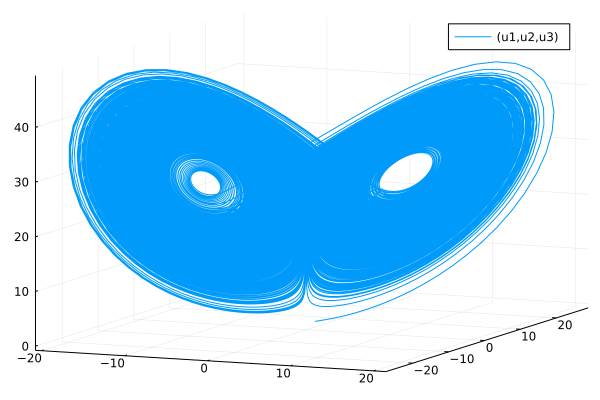

In [3]:
plot(soli, vars=(1,2,3))

In [6]:
sol_int = soli(0:0.01:100)

t: 0.0:0.01:100.0
u: 10001-element Vector{Vector{Float64}}:
 [0.8433653329613086, 0.5670469897494861, 0.6918678319656298]
 [0.8277689486739433, 0.788014616267965, 0.6792420525200815]
 [0.8345094256174669, 1.0056931285095771, 0.6687170983583277]
 [0.8614478580803412, 1.2258480203304654, 0.6604447613485055]
 [0.9070792228959955, 1.453815186107335, 0.6547431774836844]
 [0.970628657920075, 1.6944298394562174, 0.652082561477461]
 [1.0518278480231713, 1.952359902192371, 0.6531030331261808]
 [1.1508507299624129, 2.232227016064767, 0.6586418405854986]
 [1.2683469988911475, 2.538622797858198, 0.6697545087232986]
 [1.4053178357164642, 2.876342496840753, 0.6878186285583197]
 ⋮
 [3.2597656152213172, 0.002723527485838893, 26.353567764934454]
 [2.9526711191095587, 0.06410121700269793, 25.661079003659484]
 [2.6812750640742973, 0.13827610752721872, 24.98859790515842]
 [2.4432422193456964, 0.22185301550825143, 24.3355480630758]
 [2.2361865296499057, 0.3121722537731683, 23.701309576653973]
 [2.057670162

In [7]:
Array(sol_int)[]

3×10001 Matrix{Float64}:
 0.843365  0.827769  0.834509  0.861448  …   1.90526    1.77686    1.67048
 0.567047  0.788015  1.00569   1.22585       0.505933   0.607151   0.710409
 0.691868  0.679242  0.668717  0.660445     22.4867    21.905     21.3398

In [26]:
using DynamicalSystems
ds = DynamicalSystems.Systems.lorenz()
pos=poincaremap(ds, (3,27), 100000.)

Iterator of the Poincaré map of a 3-dimensional system
 rule f:      loop
 hyperplane:  (3, 27)


In [27]:
tr = trajectory(pos, 100000)
tr_plot = Matrix(tr[:,1:2])

100001×2 Matrix{Float64}:
   0.0       10.0
  17.4634    28.9337
  -8.6489    -8.90452
  -8.70644   -8.91356
  -8.71966   -8.93925
  -8.73367   -8.96651
  -8.74852   -8.99542
  -8.76427   -9.02608
  -8.78098   -9.05862
  -8.79869   -9.09316
   ⋮        
  13.5943    19.238
 -14.0494   -20.4006
  13.0355    18.0603
  15.0358    21.9433
 -11.8935   -15.8102
 -12.8173   -16.9813
 -13.6748   -19.0743
  14.5342    20.748
 -12.8267   -17.4268

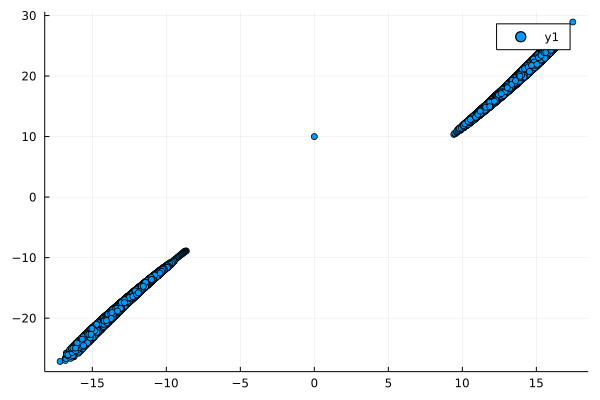

In [29]:
scatter(tr_plot[:,1], tr_plot[:,2])

In [14]:
Matrix(pos[:,1:2])

1335×2 Matrix{Float64}:
  17.4634    28.9337
  -8.6489    -8.90452
  -8.70644   -8.91356
  -8.71966   -8.93925
  -8.73367   -8.96651
  -8.74852   -8.99542
  -8.76427   -9.02608
  -8.78098   -9.05862
  -8.79869   -9.09316
  -8.81748   -9.12981
   ⋮        
 -12.4937   -16.7497
 -13.3202   -18.5709
  15.2496    23.069
 -11.4485   -14.5253
 -11.8102   -15.2558
 -12.2635   -16.2339
 -12.9252   -17.6876
 -14.2423   -20.681
  12.8836    17.6035

In [50]:
function iterate_cantor(X; α=3)
    new_iteration = []

    for x in X
        len = (x[2]-x[1])/α
        push!(new_iteration,[x[1],x[1]+len],[x[2]-len,x[2]]) 
    end 
    return new_iteration
end

iterate_cantor (generic function with 1 method)

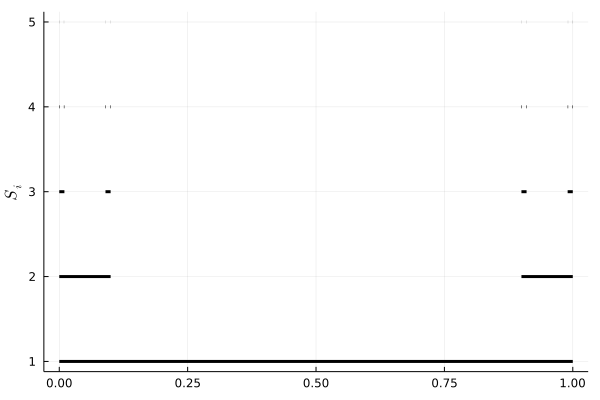

In [53]:
S_i = [[0.,1.]]

plot(0,0)
for i=1:5
    for x in S_i 
        plot!(x,[i,i],legend=nothing,color=:black,linewidth=3)
    end
    S_i = iterate_cantor(S_i, α=10)
end
plot!(0,0,ylabel=L"S_i")


In [47]:
using LaTeXStrings

code from https://github.com/abelsiqueira/koch-holidays/blob/master/koch.jl

In [57]:
using Plots

function pointskoch(points, maxk, α = sqrt(3)/2)
  Q = [0 -1; 1 0]
  for k = 1:maxk
    n = length(points)
    new_points = Vector{Float64}[]
    for i = 1:n-1
      p1, p2 = points[i], points[i+1]
      v = (p2 - p1) / 3
      q1 = p1 + v
      q2 = p1 + 1.5v + α * Q * v
      q3 = q1 + v
      append!(new_points, [p1, q1, q2, q3])
    end
    push!(new_points, points[end])
    points = new_points
  end
  return points
end

function plot_koch(points; c=:red, kwargs...)
  n = length(points)
  plot(leg=false, axis=false, grid=false, background=:white)
  px = [p[1] for p in points]
  py = [p[2] for p in points]
  plot!(px, py, c=c; kwargs...)
end

function plot_koch!(points; c=:red, kwargs...)
  n = length(points)
  px = [p[1] for p in points]
  py = [p[2] for p in points]
  plot!(px, py, c=c; kwargs...)
end

function main()
  pyplot(size=(600,300))
  points = [[0.0; 0.0], [1.0; 0.0]]
  for k = 0:7
    new_points = pointskoch(points, k)
    plot_koch(new_points)
    ylims!(-0.1, 0.4)
    png("line-koch-$k")
  end
end

objc[91559]: Class QMacAutoReleasePoolTracker is implemented in both /Users/max/.julia/artifacts/d594d9e68b9d104aaf1a41d933728d2dad54c869/lib/QtCore.framework/Versions/5/QtCore (0x1180449b8) and /Users/max/.julia/conda/3/lib/libQt5Core.5.12.9.dylib (0x16f9d1528). One of the two will be used. Which one is undefined.
objc[91559]: Class QT_ROOT_LEVEL_POOL__THESE_OBJECTS_WILL_BE_RELEASED_WHEN_QAPP_GOES_OUT_OF_SCOPE is implemented in both /Users/max/.julia/artifacts/d594d9e68b9d104aaf1a41d933728d2dad54c869/lib/QtCore.framework/Versions/5/QtCore (0x118044a30) and /Users/max/.julia/conda/3/lib/libQt5Core.5.12.9.dylib (0x16f9d15a0). One of the two will be used. Which one is undefined.
objc[91559]: Class KeyValueObserver is implemented in both /Users/max/.julia/artifacts/d594d9e68b9d104aaf1a41d933728d2dad54c869/lib/QtCore.framework/Versions/5/QtCore (0x118044a58) and /Users/max/.julia/conda/3/lib/libQt5Core.5.12.9.dylib (0x16f9d15c8). One of the two will be used. Which one is undefined.
objc[91

main (generic function with 1 method)

In [58]:
main()

In [68]:
tr = trajectory(ds, 100)

3-dimensional Dataset{Float64} with 10001 points
  0.0       10.0      0.0
  0.951226  10.0352   0.0479007
  1.82768   10.3224   0.18683
  2.6593    10.839    0.416592
  3.47133   11.5678   0.744804
  4.28518   12.496    1.18585
  5.1191    13.6125   1.76047
  5.98858   14.9063   2.49569
  6.90648   16.3638   3.42487
  7.88291   17.9659   4.58749
  ⋮                  
 10.6583    14.9151  23.8707
 11.076     15.1601  24.8565
 11.4725    15.3035  25.8985
 11.8394    15.3321  26.9806
 12.1681    15.2352  28.0829
 12.4499    15.0056  29.1824
 12.6766    14.6407  30.2542
 12.8404    14.1431  31.272
 12.9352    13.5212  32.2101

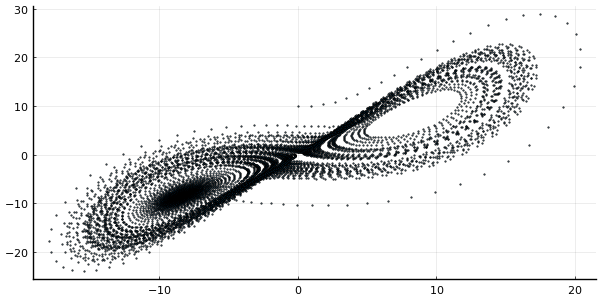

In [72]:
mat = Matrix(tr)[:,1:2]
scatter(mat[:,1],mat[:,2],markersize=0.5,legend=nothing)

In [73]:
using Fatou

Fatou detected 1 julia threads.


In [1]:
using Fatou, PyPlot
mb = mandelbrot(:(z^2+c),n=800,N=40,∂=[-1.91,0.51,-1.21,1.21],cmap="gist_earth",iter=true) 
PyPlot.plot(fatou(mb))
PyPlot.savefig("mandelbrot.pdf")

Fatou detected 1 julia threads.
  0.728850 seconds (39.64 M allocations: 1.031 GiB, 13.55% gc time, 10.77% compilation time)


In [12]:
mb = mandelbrot(:(exp(-z)+cos(c)+im*sin(c*z)),∂=[-π,π,-2,2],n=700,N=80,cmap="jet",iter=false,p=0.) 
PyPlot.plot(fatou(mb))
PyPlot.savefig("other-fractal.pdf")

  0.479527 seconds (8.76 M allocations: 233.377 MiB, 32.04% gc time, 11.14% compilation time)


In [6]:
ENV

Base.EnvDict with 34 entries:
  "ELECTRON_RUN_AS_NODE"         => "1"
  "USER"                         => "max"
  "__CFBundleIdentifier"         => "com.microsoft.VSCode"
  "COMMAND_MODE"                 => "unix2003"
  "DISPLAY"                      => "/private/tmp/com.apple.launchd.s31CZtYXIm/…
  "LOGNAME"                      => "max"
  "PATH"                         => "/usr/local/sbin:/usr/local/bin:/usr/bin:/b…
  "SSH_AUTH_SOCK"                => "/private/tmp/com.apple.launchd.W91J8LbHOZ/…
  "SHELL"                        => "/bin/bash"
  "HOME"                         => "/Users/max"
  "__CF_USER_TEXT_ENCODING"      => "0x1F5:0x0:0x0"
  "TMPDIR"                       => "/var/folders/vh/kv_4zdr96jz7s12j89cjcl7800…
  "XPC_SERVICE_NAME"             => "application.com.microsoft.VSCode.58354254.…
  "XPC_FLAGS"                    => "0x0"
  "ORIGINAL_XDG_CURRENT_DESKTOP" => "undefined"
  "VSCODE_CWD"                   => "/"
  "VSCODE_NLS_CONFIG"            => "{\"locale\":\"en-gb

In [87]:
global e = exp(1)

2.718281828459045